# Spectral Ratio of Volcano Tectonic and Long Period Events

Volcanic eruptions produce different types of seismic signals and monitoring these signals. Associated seismic signals can be classified as volcano-tectonic, long-period, tremor, explosive, tornillo and hybrid events (Ida et al., 2022; van der Laat et al., 2022). These events can be classified based on their spectral features, for example, dominant frequency band, peak amplitude, spectral ratio, amplitude decay rate, event duration etc. 

Here is an an example of types of seismicity observed in Turialba Volcano, Costa Rica by van der Laat et al., 2022. 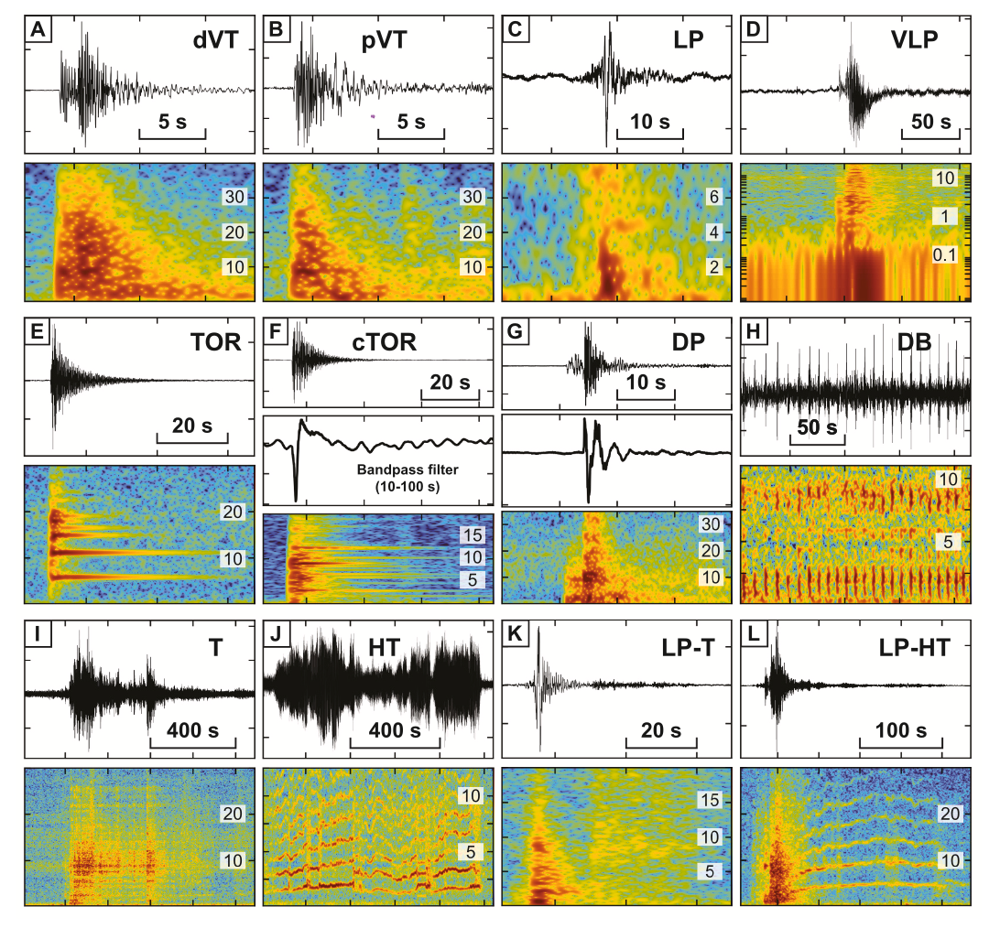

The 2018 Kilauea volcano produced about 44,000 earthquakes ranging from 1.5 < Mw < 5.4 within the caldera and the Eastern Rift Zone (Shelly & Thelen, 2019).We are analyzing seismicity associated with different eruptive phases of the Kilauea volcano, Hawaii from late April to early August of 2018. Kilauea is a phreatic volcano with a more gentle flow of lava. Therefore, all of the types of vocano seismicity might not be present here. We found Volcano Tectonic, Long Period and Tremors, by analyzing the conituous waveform as well as the avaiable seismicity catalog by USGS.  

Below is some example of the observed classes that we found in Kilauea seismicity:

# Volcano Tectonic

Volcano Tectonic (VT) events have a usual duration of less than 30 sec with dominant P and S wave arrivals. The frequency range is between 10 to 30 Hz (Ida et al., 2022; van der Laat et al., 2022). 



# Long Period

Long period events (LPs) show a lack of distinguishable phase arrivals. The peak frequency of LPs is between 5 to 10 Hz (Ida et al., 2022; van der Laat et al., 2022). 



# Tremor

Tremors have characteristics of consistent amplitude and very long durations of minutes to hours (Ida et al., 2022; van der Laat et al., 2022).



# Spectra Ratio of VT & LP

Now we are going to calculate the spectral ratio from the Power Spectral Density (PSD) of high and low frequency band of interest for Volcano Tectonic (VT) and Long Period (LP) events. Scipy and mlab have function to calculate PSD. We can use this function, or we can deine the PSD function by our own. In this example, I am going to calculate the spectral ratio of frequency band less than 5 Hz and greater than 5 Hz.

# Loading libraries

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from obspy import read, read_inventory
from obspy.core import UTCDateTime, read
import scipy.fft, scipy.signal
import pandas as pd
from matplotlib import mlab
from mpl_toolkits.axes_grid1 import make_axes_locatable
import os
import glob

The average power P of a signal x(t) over all time is therefore given by the following time average, where the period T is centered about some arbitrary time t = t0


P=   lim┬(n→∞)⁡〖1/T〗 ∫_(-∞)^∞▒〖|x_T (t)|^2 dt〗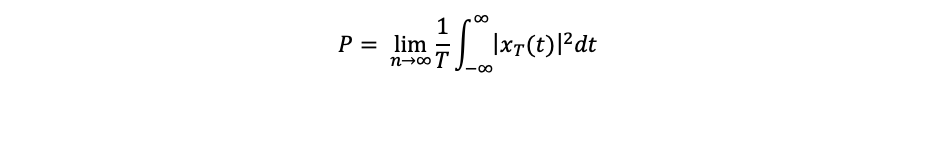

# Defining PSD 

In [2]:
def PSD_cal(x, fs):
    """ computing PSD 'manually' with SciPy"""
    xfft = scipy.fft.rfft(x)
    # normalized spec. amplitude
    xfft = abs( xfft)/len( xfft)
    # power spectral density
    PSD = xfft**2  #*(1./fs)
    return scipy.fft.rfftfreq( len(x), 1./fs), PSD


In [3]:
# from matplotlib import mlab
# PSD, freq = mlab.psd(SEIS[0].data,NFFT=1024,Fs = fs)

In [4]:
def plot_PSD(trace,freq,PSD):
    fig = plt.figure(figsize = (8,16))
    ax = plt.subplots(3,1)
    
    #plot trace
    ax1 = plt.subplot( 311)
    ax1.plot(trace.times(),trace.data, linewidth = 1)
    ax1.set_xlabel('Time(s)')
    ax1.set_ylabel('Signal')
    
    #plot spectrogram
    ax2 = plt.subplot(312, sharex = ax1)
    Fs = trace.stats.sampling_rate
    NFFT = 64
    spec,f,t,im = ax2.specgram(trace.data, NFFT, Fs, noverlap=50, detrend = 'linear', mode='psd' ,scale = 'dB', cmap='gist_rainbow_r')
    ax2.set_ylim(0,50)
    ax2.set_ylabel('Frequency [Hz]')
    #ax2.set_xlabel('Time [sec]')
    divider = make_axes_locatable(ax2)
    cax = divider.append_axes('right', size='1%', pad=0.025)
    cbar = plt.colorbar(im, cax=cax,  orientation='vertical')
    cbar.set_label('PSD in dB')
    
    #plot PSD
    ax3 = plt.subplot(313)
    ax3.set_title( f"PSD-ratio, R-e={round(f_R_E,2)}", fontsize = 10)
    ax3.loglog(freq, PSD, 'r', lw = 2, label = "PSD")
    ax3.axvline( f_thr, color = 'k', ls ='--', label = '5 Hz')
    ax3.set_xlabel( 'Frequency (Hz)')
    ax3.set_ylabel( "PSD [(mm/s)^2]")
    ax3.legend()
    plt.suptitle('%s_%s'%(trace.stats.starttime,trace.stats.station), fontsize = 12)
    plt.subplots_adjust(left=0.1,
                            bottom=0.1,
                            right=0.9,
                            top=0.9,
                            wspace=0.5,
                            hspace=0.8)
    plt.savefig('PSD_%s.jpg'%trace.stats.starttime,dpi = 1000, format = 'jpg')
    return fig

# Setting Directory Path

In [5]:
path = '/Users/rinty/Desktop/Research/Source Parameter Analysis_Python/Source_Parameter_Learning/Step1_Waveform Analysis/Kilauea_Dataset/Spectral_Ratio/LP'
os.chdir(path)
dir_list = glob.glob('*')
print(dir_list)


['LP3', 'LP2', 'LP1']


In [6]:
folder = os.path.join(path,'LP3')
os.chdir(folder)

# Load waveform

In [7]:
SEIS = read("*.sac")
k = 1
t0   = SEIS[k].stats.starttime
fs   = SEIS[k].stats.sampling_rate
n    = len(SEIS)
print('number of traces', n)

number of traces 7


# Claculate PSD and Spectral Ratio

In [8]:
freq, PSD = PSD_cal(SEIS[k].data, fs)

In [9]:
# integrating: mid-point method
f_thr = 5 #threshold frequency

#lower frequencies
l_freq = (freq <= f_thr)
f_I_l = 0.5*(PSD[l_freq][1::]+PSD[l_freq][0:-1]).sum()*(1./fs)

#higher frequencies
u_freq = (freq >= f_thr)
f_I_u = 0.5*(PSD[u_freq][1::]+PSD[u_freq][0:-1]).sum()*(1./fs)


In [10]:
f_R_E = np.log10( f_I_u/f_I_l)
print( 'PSD ratio, R_E=', round( f_R_E, 2))

PSD ratio, R_E= -2.48


<Figure size 8000x16000 with 0 Axes>

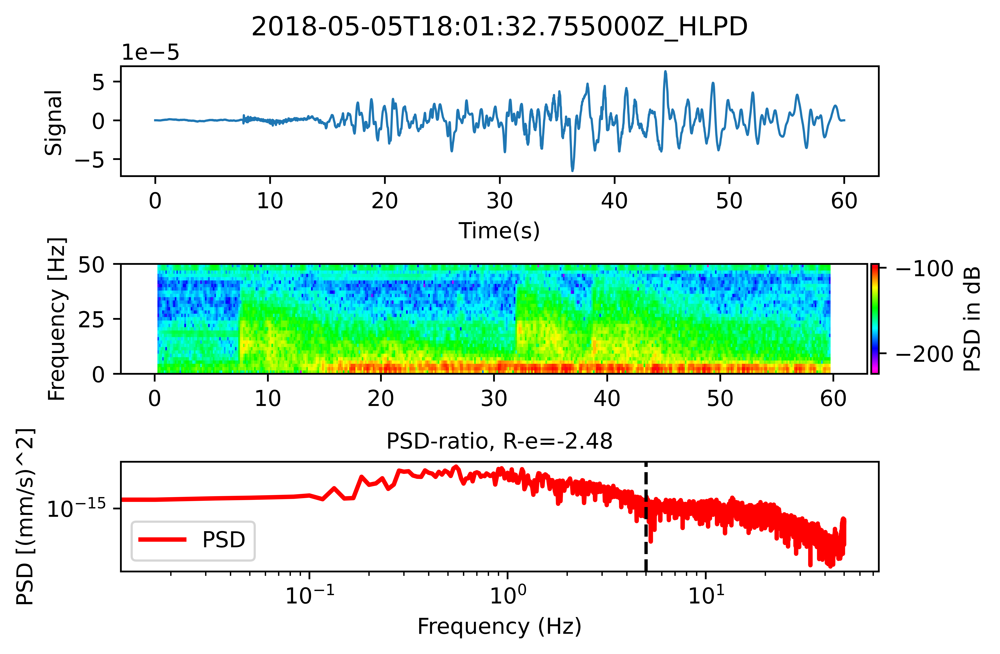

In [11]:
import matplotlib as mpl
mpl.rcParams['figure.dpi']= 1000
fig = plot_PSD(SEIS[k],freq,PSD)


# Storing the Ratio values in a CSV file

In [12]:
spec_ratio = []
station = []
for i in range(0,n):
    trace = SEIS[i]
    fs = trace.stats.sampling_rate
    freq, PSD = PSD_cal(SEIS[i].data, fs)
    # integrating: mid-point method
    f_thr = 5 #threshold frequency

    #lower frequencies
    l_freq = (freq <= f_thr)
    f_I_l = 0.5*(PSD[l_freq][1::]+PSD[l_freq][0:-1]).sum()*(1./fs)

    #higher frequencies
    u_freq = (freq >= f_thr)
    f_I_u = 0.5*(PSD[u_freq][1::]+PSD[u_freq][0:-1]).sum()*(1./fs)
    f_R_E = np.log10( f_I_u/f_I_l)
    #print( 'PSD ratio, R_E=', round( f_R_E, 2))
    spec_ratio.append(f_R_E)
    station.append(trace.stats.station)
    
spec_dic = {'station':station,'ratio':spec_ratio}


In [13]:
import pprint
pprint.pprint(spec_dic)

# saving dictionary to csv
df = pd.DataFrame.from_dict(spec_dic) 
df.to_csv('LP_%s.csv'%t0)

{'ratio': [-2.200009762885486,
           -2.4805440358853974,
           -2.0990981938930902,
           -1.8031677070634979,
           -2.2498102106673854,
           -2.0351526207067177,
           -2.0016682140167399],
 'station': ['DEVL', 'HLPD', 'STCD', 'JCUZ', 'MLOD', 'NPOC', 'PAUD']}
